# Experiment: 3D LUT Style Translation with a Cycle GAN
In an effort to stabilize the training of the generation of 3D LUTs based on unpaired image data we introduce a CycleGAN architecture in this notebook. 

CycleGAN, as introduced in the publication *Unpaired Image-to-Image Translation using Cycle-Consistent Adversarial Networks* (https://arxiv.org/pdf/1703.10593), is an approach to perform style translation from one domain to another without requiring paired image data for training.
The network consists of two generator models, *G* and *F* and two discriminator models, *Dx* and *Dy*. As in a GAN the CycleGAN uses adversarial loss. Generator *G* attempts to convert an image of domain *X* to an image that the discriminator *Dy* can not distinguish from an image of domain *Y* and generator *F* attempts to  convert an image of domain *Y* to an image that the discriminator *Dx* can not distinguish from an image of domain *X*. In addition to that they introduced two cycle consistency losses that "capture the intuition that if we translate from one domain to the other and back again we should arrive at where we started: forward cycle-consistency loss: x → G(x) → F (G(x)) ≈ x, and backward cycle-consistency loss: y → F (y) → G(F(y)) ≈ y" [Source](https://arxiv.org/pdf/1703.10593). 

To help preserve the color of the input images and to avoid a tint change where it is not necessary, it is recommended to use an additional identity mapping loss as introduced in Taigman et al. [Source](https://arxiv.org/pdf/1611.02200). If *G* gets an input image that is already of domain *Y* and *F* gets an input image that is already of domain *X* we expect an identity mapping. 
In comparison to the previously used GAN architecture we hope to introduce greater stability with the introduction of the CycleGAN architecture and assume that the artifacts and broken color transitions could be reduced due to the cycle-consistency and identity mapping loss.

Source: https://arxiv.org/pdf/1703.10593

## Imports

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import numpy as np
from torchvision import transforms
from tqdm import tqdm
from PIL import Image
from IPython.display import display
import os
import matplotlib.pyplot as plt
from pytorch_msssim import ssim, ms_ssim # https://pypi.org/project/pytorch-msssim/
import torchvision.transforms.functional as TF
import torchvision.utils as vutils
from torchinfo import summary
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torchvision.utils import save_image

C:\Users\Niko\anaconda3\envs\FilmGAN_01\Lib\site-packages\albumentations\__init__.py:24: UserWarning: A new version of Albumentations is available: '2.0.4' (you have '2.0.0'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


## Training data
One limitation of CycleGAN is that we can no longer test the translation of colored images to black and white images, as it is impossible to transform black and white images back to color images with a 3D LUT  which would be necessary for the cycle-consistency loss. Instead, we are going to train our CycleGAN directly on translation between different analog films. We are using 250 images of Cinestill 800T and 250 images of Kodak Portra 400. Cinestill 800T is known for its cool-toned images where as Kodak Portra 400 is known for its "sunny feel" and natural skin tones . As in GAN training we downsample the images to a resolution of 64 x 64 pixel. In this experiment, we aim to enable the translation between different color films with the usage of unpaired image data for the first time, and we want to reduce the amount of artifacts and increase the stability of training.

## Hyperparameters

In [2]:
batch_size = 64
learning_rate = 1e-5
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
num_epochs = 5000

num_workers = 4
lambda_cycle = 4
lambda_identity = 0.5

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of feature maps in discriminator
ndf = 64

# Checkpoint file paths
experiment = "cinestill_portra_v3"
check_G_A2B = "G_A2B.pth.tar"
check_G_B2A = "G_B2A.pth.tar"
check_D_A =  "D_A.pth.tar"
check_D_B = "D_B.pth.tar"

name_graded = "Kodak_Portra"
name_ungraded = "Cinestill"

## Dataset

In [3]:
class PairedImageDataset(Dataset):
    def __init__(self, ungraded_images, graded_images, transform=None):
        self.ungraded_images = ungraded_images
        self.graded_images = graded_images
        self.transform = transform

    def __len__(self):
        return len(self.ungraded_images)

    def __getitem__(self, idx):
        ungraded = self.ungraded_images[idx]
        graded = self.graded_images[idx]
        if self.transform:
            ungraded = self.transform(ungraded)
            graded = self.transform(graded)
            #augmentations = self.transform(image=ungraded, image0=graded)
            #ungraded = augmentations["image"]
            #graded = augmentations["image0"]
        return ungraded, graded

In [4]:
transform64 = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
])

In [6]:
def load_images_from_directory(directory_path, num_images=100):
    images = []
    files = os.listdir(directory_path)
    # Ensure only images are processed
    image_files = [f for f in files if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    
    for i, image_file in enumerate(image_files[:num_images]):
        image_path = os.path.join(directory_path, image_file)
        img = Image.open(image_path).convert('RGB')  # Convert to RGB in case of grayscale
        img = transform64(img)  # Apply the transformations
        images.append(img)
        
    images_tensor = torch.stack(images)
    images_tensor = images_tensor.permute(0, 2, 3, 1)
    return images_tensor

graded_images = load_images_from_directory('../../analogdb_images/kodak_portra_400', num_images=250)
ungraded_images = load_images_from_directory('../../analogdb_images/cinestill_800t', num_images=250)

# Verify the shape of the tensors
print(ungraded_images.shape)  # Should be [num_images, 64, 64, 3]
print(graded_images.shape)    # Should be [num_images, 64, 64, 3]

C:\Users\Niko\anaconda3\envs\FilmGAN_01\Lib\site-packages\PIL\Image.py:3186: DecompressionBombWarning: Image size (93660198 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


torch.Size([250, 64, 64, 3])
torch.Size([250, 64, 64, 3])


In [7]:
transform = transforms.Compose([transforms.ToTensor()])

In [8]:
transformFlip = A.Compose(
    [
        A.Resize(width=64, height=64),
        A.HorizontalFlip(p=0.5),
        A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5], max_pixel_value=255),
        ToTensorV2(),
    ],
    additional_targets={"image0": "image"},
) # Source: https://colab.research.google.com/drive/1BuI-9P1-ku00Nc1tPbBhoeL006-3tNUS?usp=sharing#scrollTo=LWqoRijtmm6n

In [9]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [10]:
ungraded_images_np = ungraded_images.numpy()
graded_images_np = graded_images.numpy()

dataset = PairedImageDataset(ungraded_images_np, graded_images_np, transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

## Visualization of the Training data

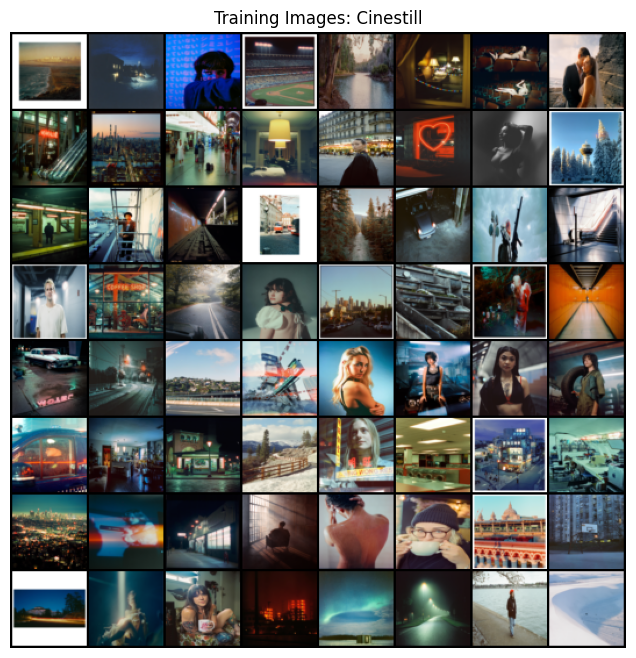

In [11]:
# Plot some training images
display_dataloader = DataLoader(dataset, batch_size=64, shuffle=True)
ungraded, graded = next(iter(display_dataloader))

plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Training Images: {name_ungraded}")
plt.imshow(np.transpose(vutils.make_grid(ungraded.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

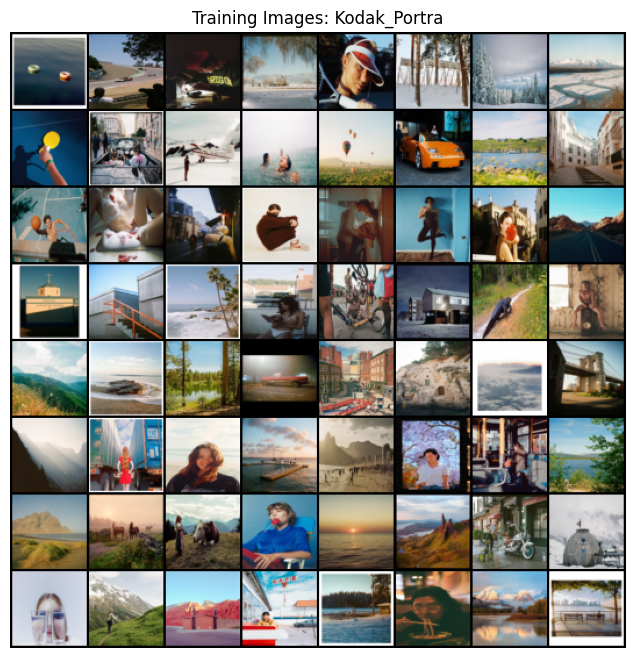

In [12]:
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title(f"Training Images: {name_graded}")
plt.imshow(np.transpose(vutils.make_grid(graded.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Models

From the DCGAN paper, the authors specify that all model weights shall be randomly initialized from a Normal distribution with mean=0, stdev=0.02. The weights_init function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria. This function is applied to the models immediately after initialization.

https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [21]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator
Against our expectations, we experienced greater instability than in GAN training. Therefore, we decided to simplify the model used and reverted back to a simple CNN with three convolutional layers with filter size 3 and ReLU activation, as well as max pooling after each layer as our feature extractor.

Based on https://www.digitalocean.com/community/tutorials/writing-cnns-from-scratch-in-pytorch?utm_source=chatgpt.com and https://arxiv.org/pdf/2009.14468

In [13]:
class LUTGenerator(nn.Module):
    def __init__(self, lut_size=8):
        super(LUTGenerator, self).__init__()
        self.lut_size = lut_size
        self.cnn = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.AdaptiveAvgPool2d(1)
        )
        #self.fc = nn.Linear(128, lut_size * lut_size * lut_size * 3)  # Output LUT values
        self.lut_generator = nn.Sequential(
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(256, lut_size * lut_size * lut_size * 3)
        )

    def _trilinear_interpolation(self,luts, images):
        # Scale images to be between -1 and 1
        img = (images - 0.5) * 2.0  # Shape: [4, 3, 256, 256]
        
        # Add a singleton dimension to represent "channel" for LUT interpolation
        img = img.permute(0, 2, 3, 1).unsqueeze(1)  # Shape: [4, 1, 256, 256, 3]

        # Ensure LUT is in the correct format
        LUT = luts.permute(0, 4, 1, 2, 3)  # Shape: [4, 3, 8, 8, 8]
        
        # Perform grid sampling for each channel
        result = F.grid_sample(LUT, img, mode='bilinear', padding_mode='border', align_corners=True)  # [4, 3, 1, 256, 256]
    
        # Remove the singleton dimension and permute to the correct format
        result = result.squeeze(2)  # Remove the extra "depth" dimension: [4, 3, 256, 256]
    
        return result

    def _simple_approach(self, luts, images):
        lut = luts.view(luts.shape[0], luts.shape[2], luts.shape[2], luts.shape[2], 3)
        image_normalized = (images * luts.shape[2]-1).long()
        image_normalized = torch.clamp(image_normalized, 0, luts.shape[2]-1)
            
        r = image_normalized[:, 0, :, :]
        g = image_normalized[:, 1, :, :]
        b = image_normalized[:, 2, :, :]
            
        transformed = lut[torch.arange(luts.shape[0]).unsqueeze(-1).unsqueeze(-1), r, g, b]
        transformed = transformed.permute(0, 3, 1, 2)

        return transformed


    def forward(self, x):
        x_orig = x
        batch_size = x.size(0)
        features = self.cnn(x)
        features = features.view(features.size(0), -1)  # Flatten
        #lut = self.fc(features)
        lut = self.lut_generator(features)
        lut = lut.view(-1, self.lut_size, self.lut_size, self.lut_size, 3)
        lut = torch.sigmoid(lut)

        transformed = self._trilinear_interpolation(lut, x_orig)
        return transformed, lut

In [14]:
sample_input = torch.rand(4, 3, 64, 64).to(device)
LUTGeneratorCNN=LUTGenerator(lut_size=9).to(device)
# Initialize weights
#weights_init(LUTGeneratorCNN)
transformed, lut = LUTGeneratorCNN(sample_input)
print(lut.shape)
print(transformed.shape)

torch.Size([4, 9, 9, 9, 3])
torch.Size([4, 3, 64, 64])


In [15]:
summary(LUTGeneratorCNN)

Layer (type:depth-idx)                   Param #
LUTGenerator                             --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       896
│    └─ReLU: 2-2                         --
│    └─MaxPool2d: 2-3                    --
│    └─Conv2d: 2-4                       18,496
│    └─ReLU: 2-5                         --
│    └─MaxPool2d: 2-6                    --
│    └─Conv2d: 2-7                       73,856
│    └─ReLU: 2-8                         --
│    └─AdaptiveAvgPool2d: 2-9            --
├─Sequential: 1-2                        --
│    └─Linear: 2-10                      33,024
│    └─ReLU: 2-11                        --
│    └─Linear: 2-12                      562,059
Total params: 688,331
Trainable params: 688,331
Non-trainable params: 0

## Discriminator

As mentioned, the discriminator, D, is a binary classification network that takes an image as input and outputs a scalar probability that the input image is real (as opposed to fake). Here, D takes a 3x64x64 input image, processes it through a series of Conv2d, BatchNorm2d, and LeakyReLU layers, and outputs the final probability through a Sigmoid activation function. This architecture can be extended with more layers if necessary for the problem, but there is significance to the use of the strided convolution, BatchNorm, and LeakyReLUs. The DCGAN paper mentions it is a good practice to use strided convolution rather than pooling to downsample because it lets the network learn its own pooling function. Also batch norm and leaky relu functions promote healthy gradient flow which is critical for the learning process of both G and D.

Source: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [16]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

## Train Cycle GAN

Source:
https://isaac-flath.github.io/fastblog/computer%20vision/gan/2021/03/20/CycleGanWalkThrough.html#Generator

Different approach: https://medium.com/@chilldenaya/cyclegan-introduction-pytorch-implementation-5b53913741ca

In [17]:
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)#, pin_memory=True)#, num_workers=num_workers, pin_memory=True)

In [18]:
def display_images(images, titles=None):
    # Three subplots in one row
    fig, axes = plt.subplots(1, 4, figsize=(8, 4))
    
    # Convert and display each image
    for idx, (ax, img) in enumerate(zip(axes, [images[0], images[1], images[2], images[3]])):
        # Convert tensor to numpy array
        tensor_image = img.detach().cpu()
        image_np = np.transpose(tensor_image.numpy(), (1, 2, 0))
        image_np = (image_np * 255).clip(0, 255).astype(np.uint8)
        
        # Display the image
        ax.imshow(image_np)
        ax.axis('off')
        
        # Set title if provided
        if titles and idx < len(titles):
            ax.set_title(titles[idx])
    
    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()

In [19]:
def train_cycle_gan(netD_A, netD_B, netG_A2B, netG_B2A, dataloader, opt_disc, opt_gen, L1, mse, d_scaler, g_scaler, num_epochs):
    B_reals = 0
    B_fakes = 0
    #loop = tqdm(dataloader, leave=True)
    G_Losses = []
    D_Losses = []

    for epoch in tqdm(range(num_epochs)):
        running_G_Loss = 0.0
        running_D_Loss = 0.0
        for idx, (ungraded, graded) in enumerate(dataloader):
            ungraded = ungraded.to(device)
            graded = graded.to(device)
    
            # Train discriminators A and B
            with torch.amp.autocast('cuda'):
                # Disc loss
                fake_graded, _ = netG_A2B(ungraded)
                D_B_real = netD_B(graded)
                D_B_fake = netD_B(fake_graded.detach())
                #B_reals += D_B_real.mean().item()
                #B_fakes += D_B_fake.mean().item()
                D_B_real_loss = mse(D_B_real, torch.ones_like(D_B_real))
                D_B_fake_loss = mse(D_B_fake, torch.zeros_like(D_B_fake))
                D_B_loss = D_B_real_loss + D_B_fake_loss
    
                fake_ungraded, _ = netG_B2A(graded)
                D_A_real = netD_A(ungraded)
                D_A_fake = netD_A(fake_ungraded.detach())
                D_A_real_loss = mse(D_A_real, torch.ones_like(D_A_real))
                D_A_fake_loss = mse(D_A_fake, torch.zeros_like(D_A_fake))
                D_A_loss = D_A_real_loss + D_A_fake_loss
    
                D_loss = (D_B_loss + D_A_loss) / 2
    
            opt_disc.zero_grad()
            d_scaler.scale(D_loss).backward()
            d_scaler.step(opt_disc)
            d_scaler.update()
            running_D_Loss += D_loss
    
            # Train generators A2B and B2A
            with torch.amp.autocast('cuda'):
                # adversarial losses
                D_B_fake = netD_B(fake_graded)
                D_A_fake = netD_A(fake_ungraded)
                loss_G_B = mse(D_B_fake, torch.ones_like(D_B_fake))
                loss_G_A = mse(D_A_fake, torch.ones_like(D_A_fake))
    
                # cycle losses
                cycle_ungraded, _ = netG_B2A(fake_graded)
                cycle_graded, _ = netG_A2B(fake_ungraded)
                cycle_ungraded_loss = L1(ungraded, cycle_ungraded)
                cycle_graded_loss = L1(graded, cycle_graded)
    
                # identity losses
                identity_ungraded, _ = netG_B2A(ungraded)
                identity_graded, _ = netG_A2B(graded)
                identity_ungraded_loss = L1(ungraded, identity_ungraded)
                identity_graded_loss = L1(graded, identity_graded)
                
                # total loss
                G_loss = (
                    loss_G_B
                    + loss_G_A
                    + cycle_ungraded_loss * lambda_cycle
                    + cycle_graded_loss * lambda_cycle
                    + identity_ungraded_loss * lambda_identity
                    + identity_graded_loss * lambda_identity
                )
        
            opt_gen.zero_grad()
            g_scaler.scale(G_loss).backward()
            g_scaler.step(opt_gen)
            g_scaler.update()
            running_G_Loss += G_loss

        
        G_Losses.append(running_G_Loss / len(dataloader))
        D_Losses.append(running_D_Loss / len(dataloader))
        
        if epoch % 50 == 0:
            display_images([ungraded[0], fake_graded[0], graded[0], fake_ungraded[0]], [f"original_{name_ungraded}", f"fake_{name_graded}", f"original_{name_graded}", f"fake_{name_ungraded}"])
            
        if epoch % 200 == 0:
            save_image(fake_graded[0], f"outputs/fake_{name_graded}_{epoch}.png")
            save_image(fake_ungraded[0], f"outputs/fake_{name_ungraded}_{epoch}.png")

    return G_Losses, D_Losses

In [22]:
netG_A2B = LUTGenerator(lut_size=16).to(device) # A is ungraded, B graded
netG_B2A = LUTGenerator(lut_size=16).to(device)

netD_A = Discriminator().to(device)
netD_B = Discriminator().to(device)

# Initialize weights:
weights_init(netG_A2B)
weights_init(netG_B2A)
weights_init(netD_A)
weights_init(netD_B)

In [23]:
# use Adam Optimizer for both generator and discriminator
opt_disc = optim.Adam(
    list(netD_A.parameters()) + list(netD_B.parameters()),
    lr=learning_rate/100,
    betas=(0.5, 0.999),
)

opt_gen = optim.Adam(
    list(netG_A2B.parameters()) + list(netG_B2A.parameters()),
    lr=learning_rate,
    betas=(0.5, 0.999),
)

L1 = nn.L1Loss()
mse = nn.MSELoss()

#criterion = nn.BCELoss()
#criterion_identity = nn.L1Loss()
#criterion_cycle = nn.L1Loss()

g_scaler = torch.amp.GradScaler('cuda')
d_scaler = torch.amp.GradScaler('cuda')

  0%|                                                                                         | 0/5000 [00:00<?, ?it/s]

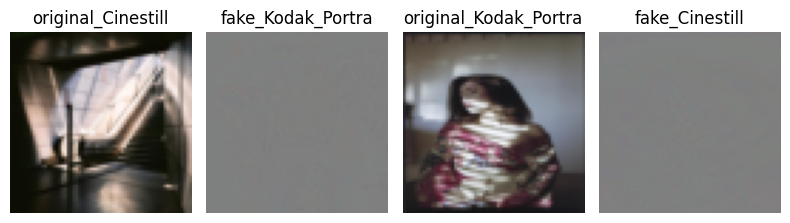

  1%|▊                                                                               | 50/5000 [00:13<20:52,  3.95it/s]

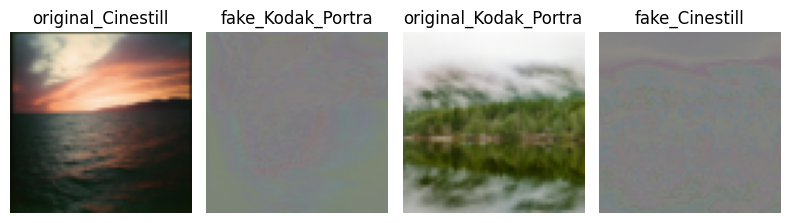

  2%|█▌                                                                             | 100/5000 [00:26<20:15,  4.03it/s]

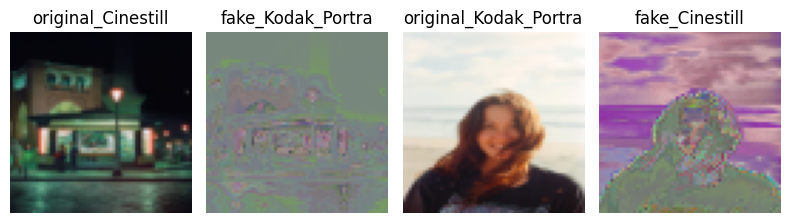

  3%|██▎                                                                            | 150/5000 [00:40<25:23,  3.18it/s]

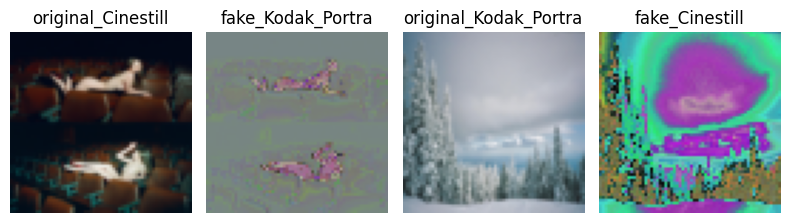

  4%|███▏                                                                           | 200/5000 [00:53<23:27,  3.41it/s]

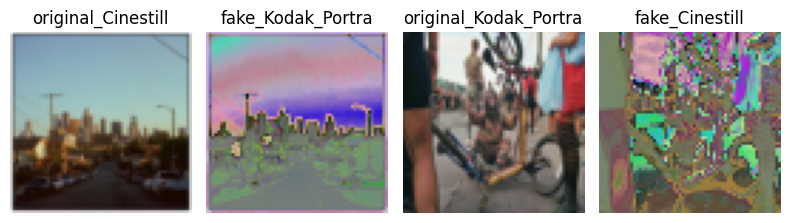

  5%|███▉                                                                           | 250/5000 [01:07<20:50,  3.80it/s]

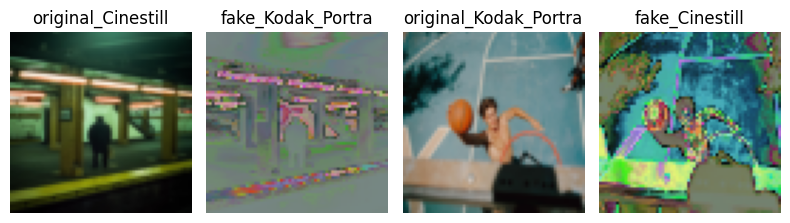

  6%|████▋                                                                          | 300/5000 [01:20<19:48,  3.95it/s]

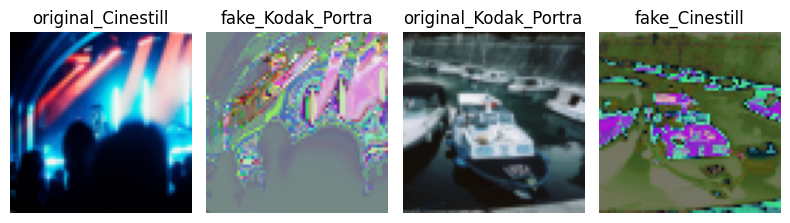

  7%|█████▌                                                                         | 350/5000 [01:34<20:46,  3.73it/s]

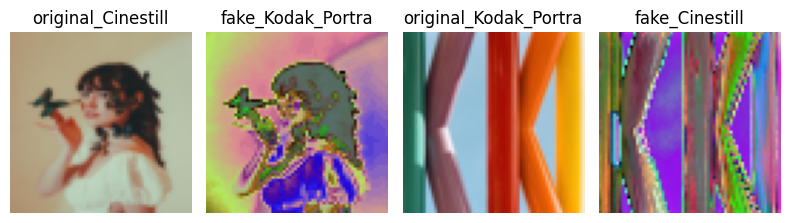

  8%|██████▎                                                                        | 400/5000 [01:48<19:12,  3.99it/s]

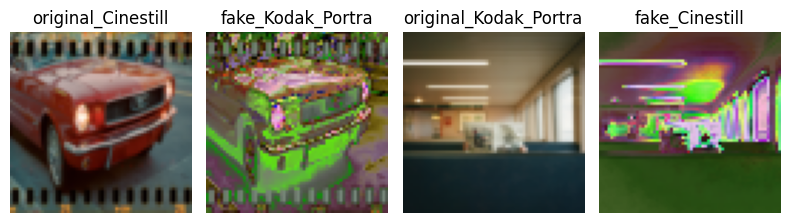

  9%|███████                                                                        | 450/5000 [02:01<19:26,  3.90it/s]

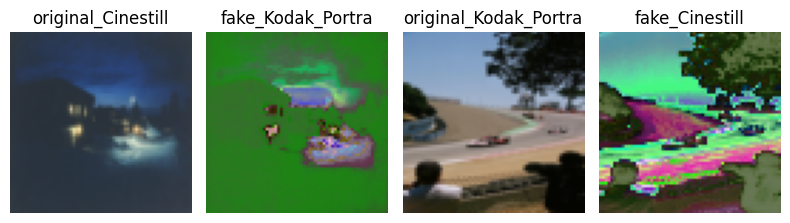

 10%|███████▉                                                                       | 500/5000 [02:17<20:22,  3.68it/s]

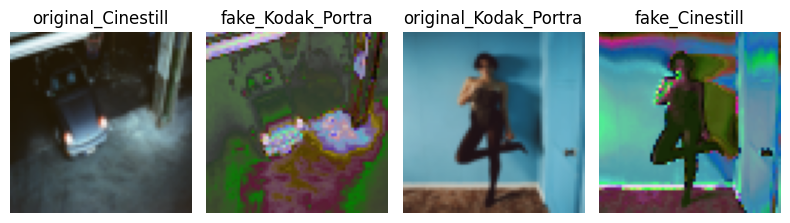

 11%|████████▋                                                                      | 550/5000 [02:30<18:14,  4.06it/s]

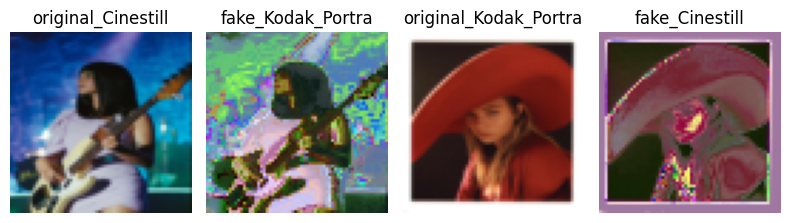

 12%|█████████▍                                                                     | 600/5000 [02:42<17:53,  4.10it/s]

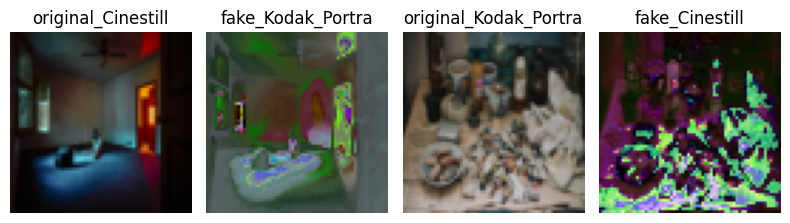

 13%|██████████▎                                                                    | 650/5000 [02:55<18:11,  3.99it/s]

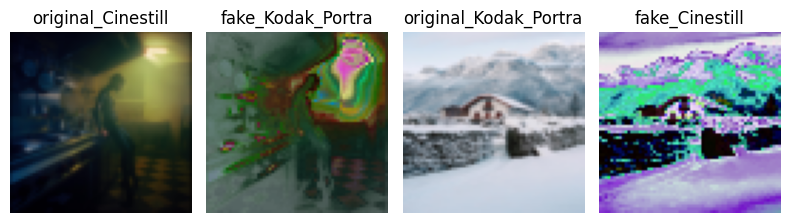

 14%|███████████                                                                    | 700/5000 [03:08<17:32,  4.09it/s]

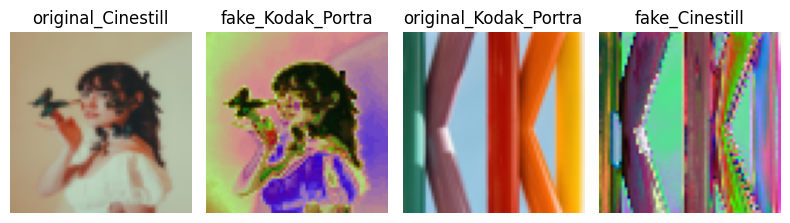

 15%|███████████▊                                                                   | 750/5000 [03:21<19:01,  3.72it/s]

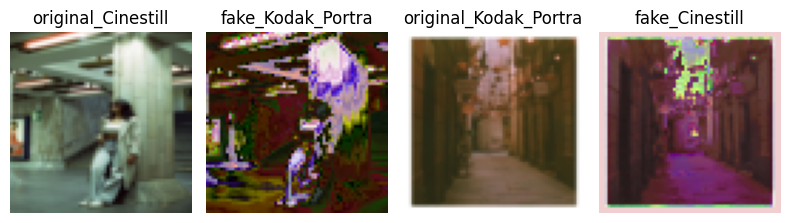

 16%|████████████▋                                                                  | 800/5000 [03:33<17:13,  4.06it/s]

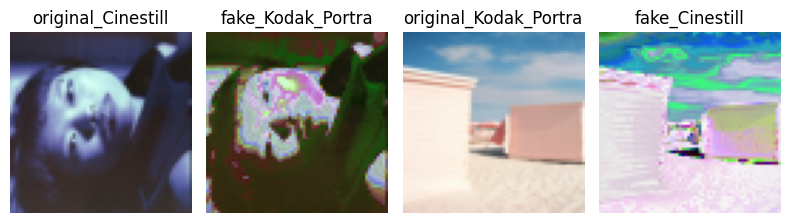

 17%|█████████████▍                                                                 | 850/5000 [03:46<17:22,  3.98it/s]

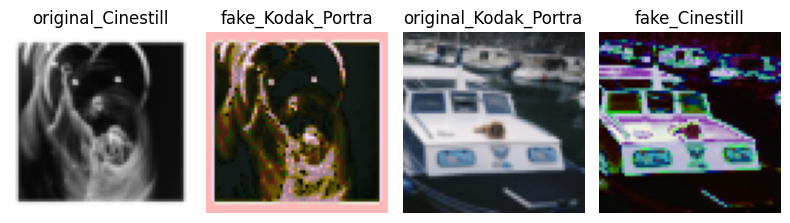

 18%|██████████████▏                                                                | 900/5000 [03:59<16:43,  4.09it/s]

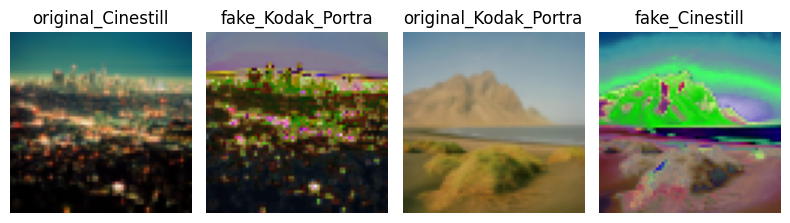

 19%|███████████████                                                                | 950/5000 [04:11<17:11,  3.93it/s]

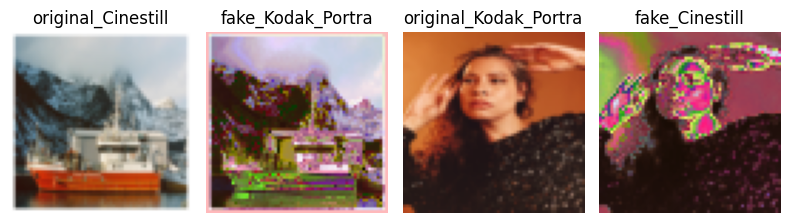

 20%|███████████████▌                                                              | 1000/5000 [04:24<16:22,  4.07it/s]

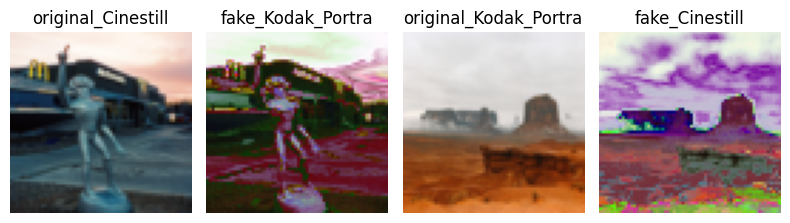

 21%|████████████████▍                                                             | 1050/5000 [04:37<16:11,  4.07it/s]

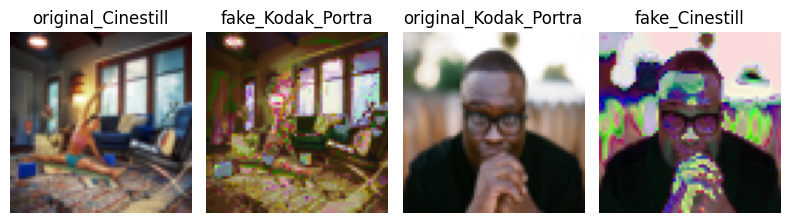

 22%|█████████████████▏                                                            | 1100/5000 [04:49<16:44,  3.88it/s]

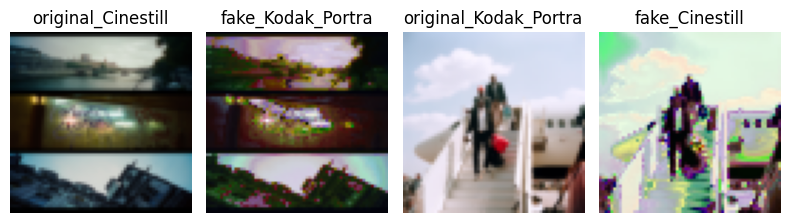

 23%|█████████████████▉                                                            | 1150/5000 [05:03<16:13,  3.96it/s]

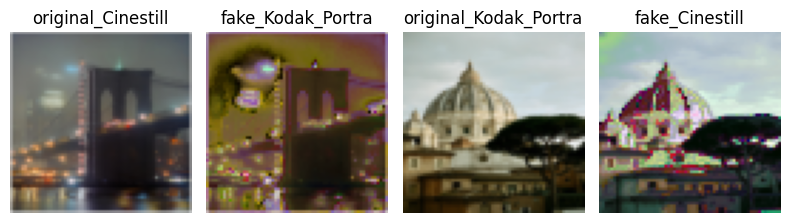

 24%|██████████████████▋                                                           | 1200/5000 [05:17<16:35,  3.82it/s]

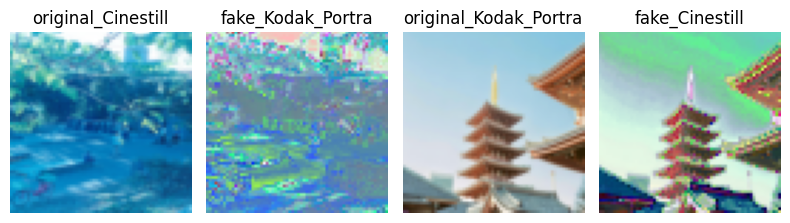

 25%|███████████████████▌                                                          | 1250/5000 [05:30<15:19,  4.08it/s]

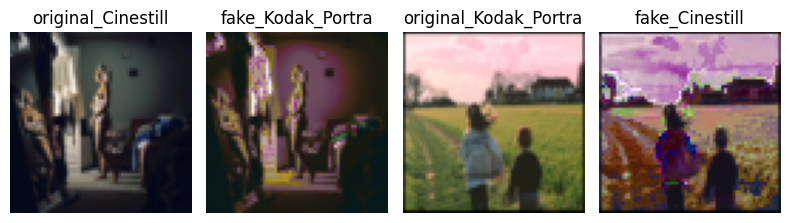

 26%|████████████████████▎                                                         | 1300/5000 [05:43<15:32,  3.97it/s]

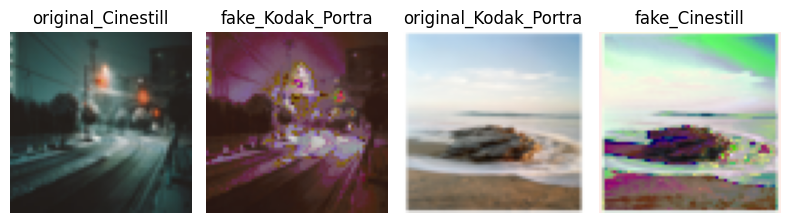

 27%|█████████████████████                                                         | 1350/5000 [05:56<15:23,  3.95it/s]

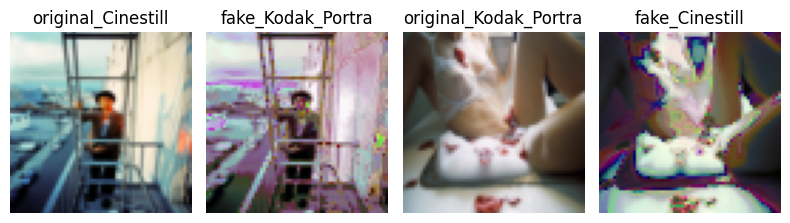

 28%|█████████████████████▊                                                        | 1400/5000 [06:09<14:47,  4.06it/s]

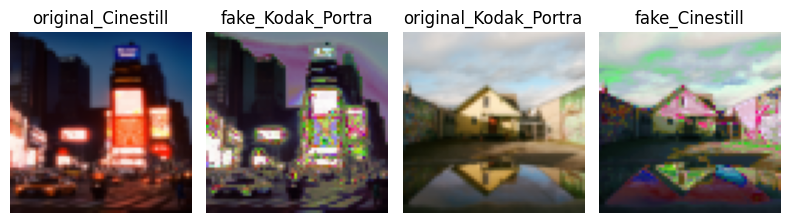

 29%|██████████████████████▌                                                       | 1450/5000 [06:22<14:23,  4.11it/s]

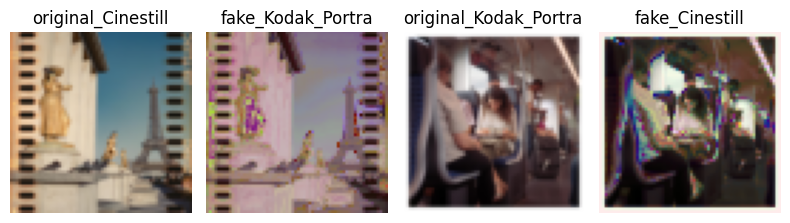

 30%|███████████████████████▍                                                      | 1500/5000 [06:34<14:26,  4.04it/s]

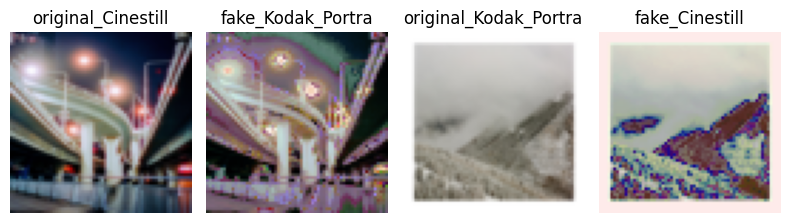

 31%|████████████████████████▏                                                     | 1550/5000 [06:47<14:06,  4.08it/s]

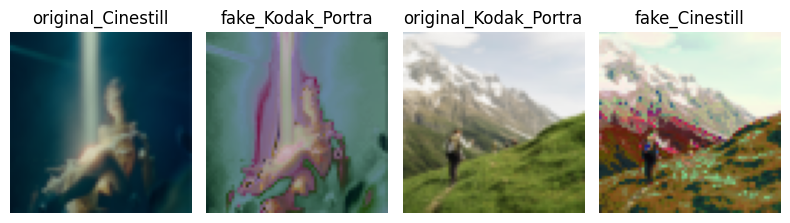

 32%|████████████████████████▉                                                     | 1600/5000 [07:00<13:49,  4.10it/s]

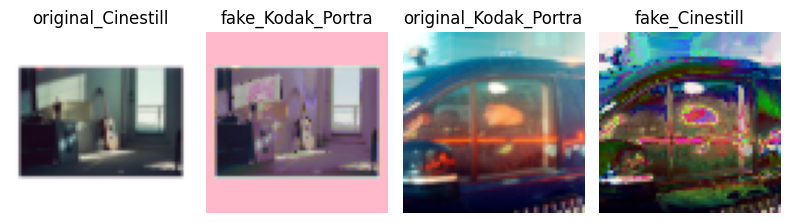

 33%|█████████████████████████▋                                                    | 1650/5000 [07:14<14:37,  3.82it/s]

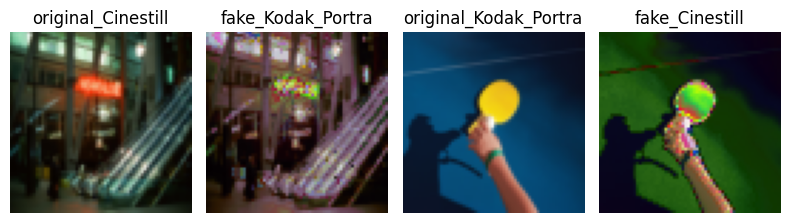

 34%|██████████████████████████▌                                                   | 1700/5000 [07:28<14:41,  3.74it/s]

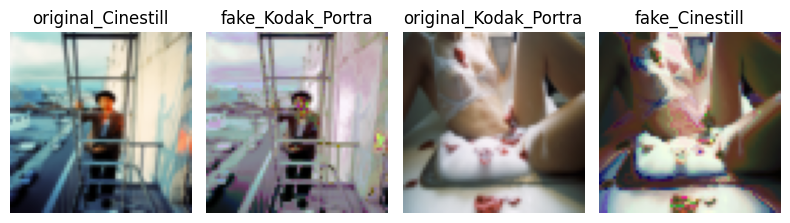

 35%|███████████████████████████▎                                                  | 1750/5000 [07:43<17:22,  3.12it/s]

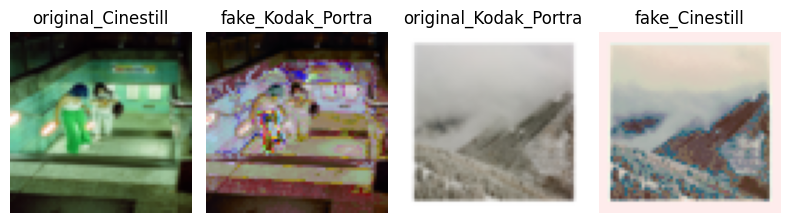

 36%|████████████████████████████                                                  | 1800/5000 [07:58<16:46,  3.18it/s]

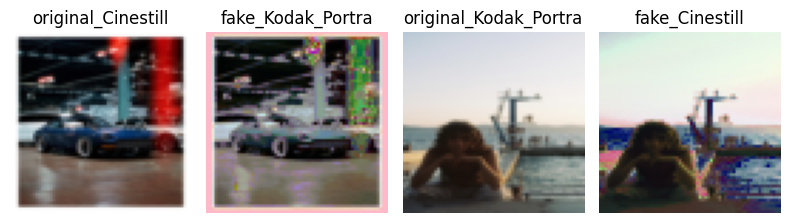

 37%|████████████████████████████▊                                                 | 1850/5000 [08:11<12:54,  4.07it/s]

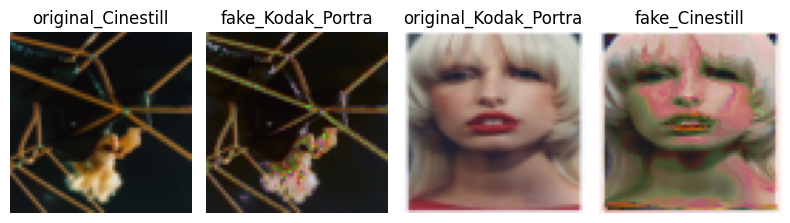

 38%|█████████████████████████████▋                                                | 1900/5000 [08:24<13:03,  3.95it/s]

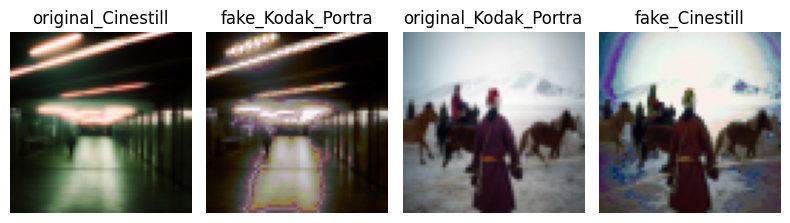

 39%|██████████████████████████████▍                                               | 1950/5000 [08:38<13:37,  3.73it/s]

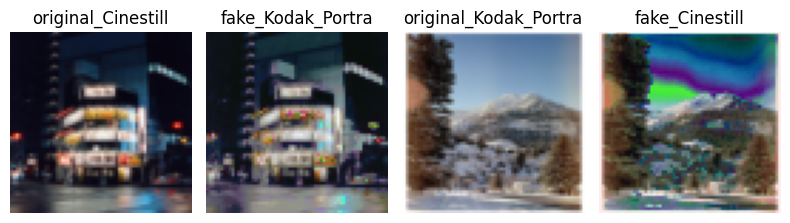

 40%|███████████████████████████████▏                                              | 2000/5000 [08:51<12:14,  4.08it/s]

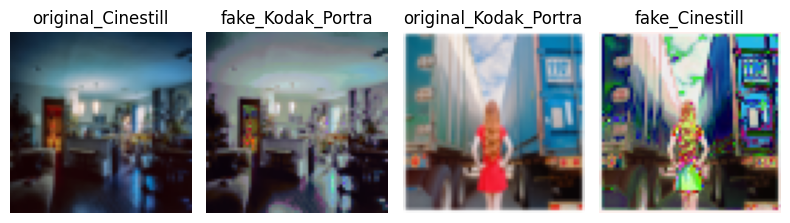

 41%|███████████████████████████████▉                                              | 2050/5000 [09:03<12:17,  4.00it/s]

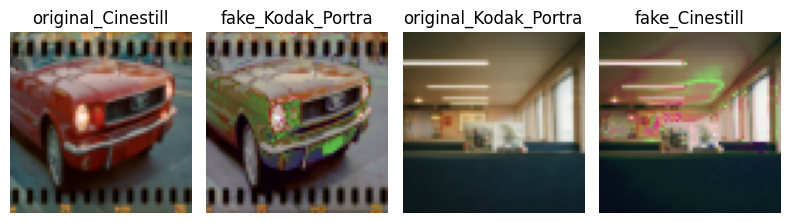

 42%|████████████████████████████████▊                                             | 2100/5000 [09:17<13:23,  3.61it/s]

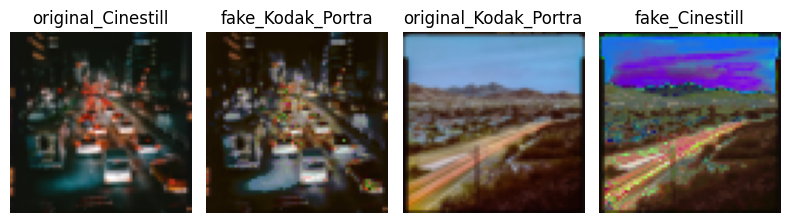

 43%|█████████████████████████████████▌                                            | 2150/5000 [09:33<14:35,  3.25it/s]

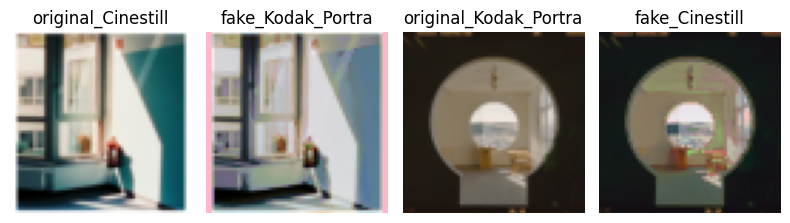

 44%|██████████████████████████████████▎                                           | 2200/5000 [09:47<11:58,  3.90it/s]

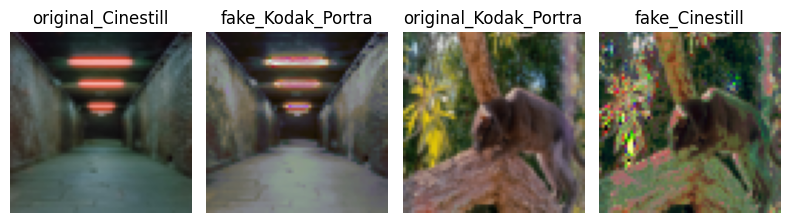

 45%|███████████████████████████████████                                           | 2250/5000 [10:00<11:27,  4.00it/s]

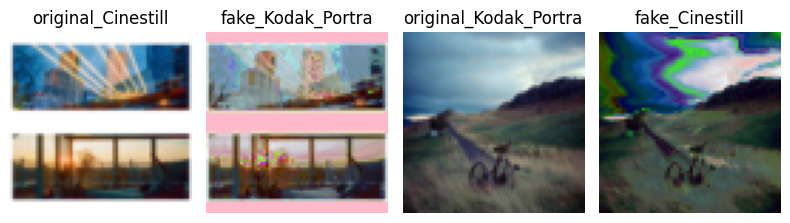

 46%|███████████████████████████████████▉                                          | 2300/5000 [10:13<10:58,  4.10it/s]

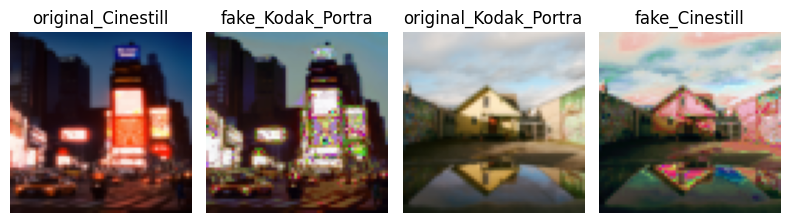

 47%|████████████████████████████████████▋                                         | 2350/5000 [10:27<12:35,  3.51it/s]

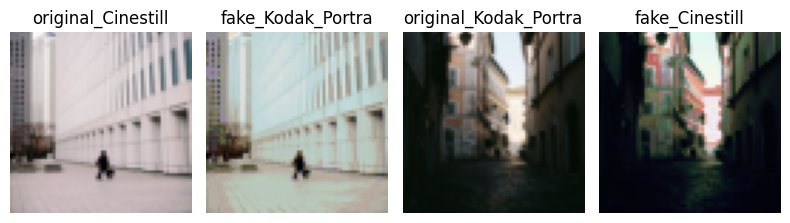

 48%|█████████████████████████████████████▍                                        | 2400/5000 [10:40<10:36,  4.08it/s]

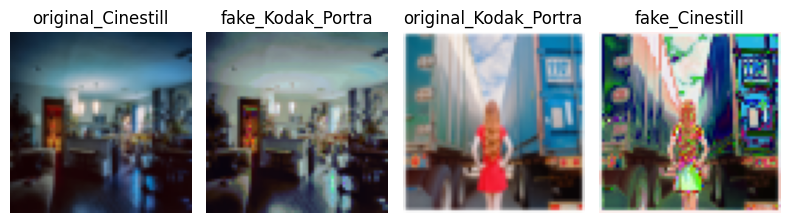

 49%|██████████████████████████████████████▏                                       | 2450/5000 [10:53<10:23,  4.09it/s]

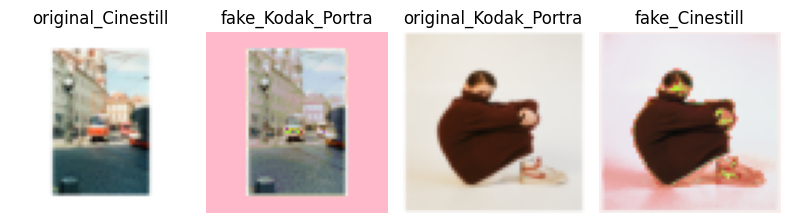

 50%|███████████████████████████████████████                                       | 2500/5000 [11:06<11:01,  3.78it/s]

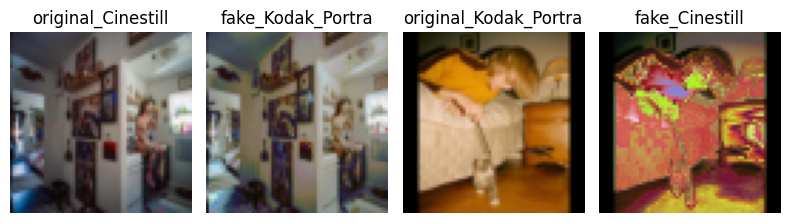

 51%|███████████████████████████████████████▊                                      | 2550/5000 [11:19<09:57,  4.10it/s]

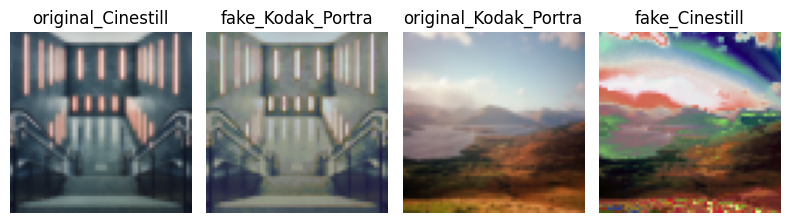

 52%|████████████████████████████████████████▌                                     | 2600/5000 [11:31<09:40,  4.13it/s]

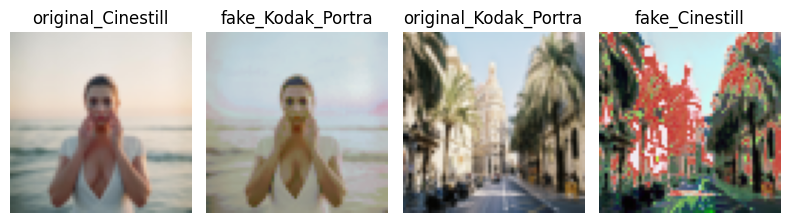

 53%|█████████████████████████████████████████▎                                    | 2650/5000 [11:44<09:54,  3.95it/s]

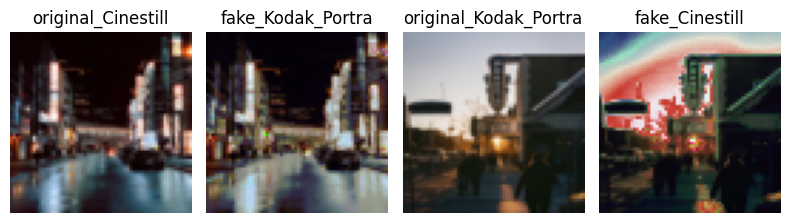

 54%|██████████████████████████████████████████                                    | 2700/5000 [11:57<09:44,  3.94it/s]

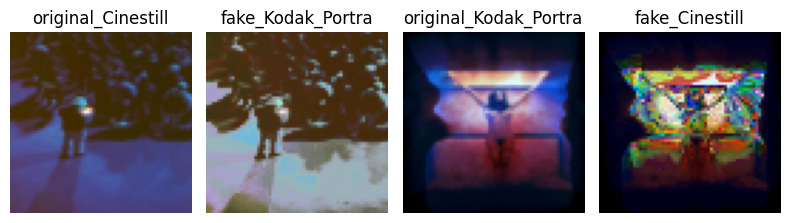

 55%|██████████████████████████████████████████▉                                   | 2750/5000 [12:09<11:00,  3.40it/s]

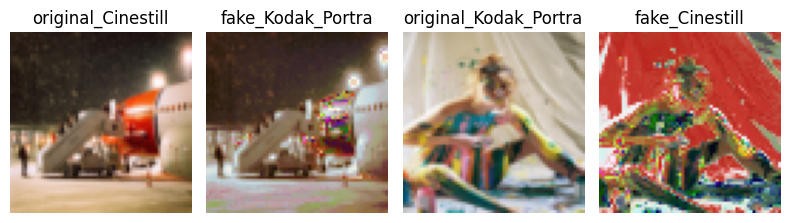

 56%|███████████████████████████████████████████▋                                  | 2800/5000 [12:23<10:05,  3.64it/s]

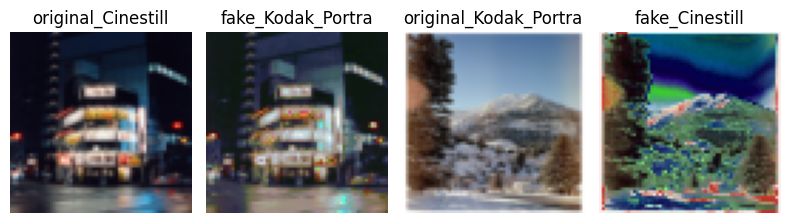

 57%|████████████████████████████████████████████▍                                 | 2850/5000 [12:38<10:17,  3.48it/s]

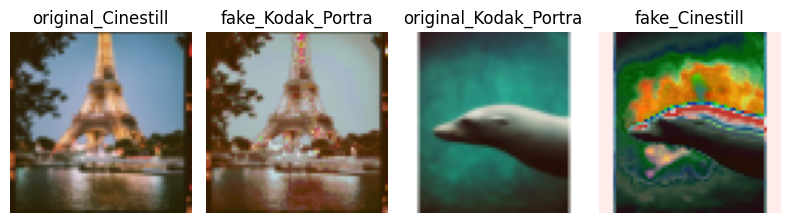

 58%|█████████████████████████████████████████████▏                                | 2900/5000 [12:51<09:27,  3.70it/s]

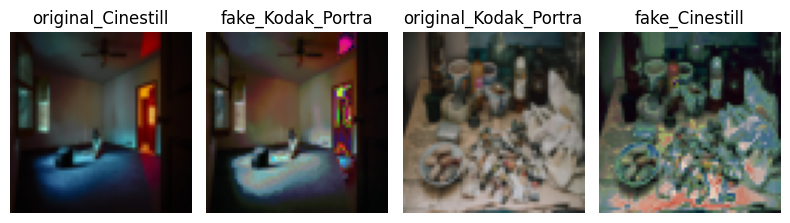

 59%|██████████████████████████████████████████████                                | 2950/5000 [13:04<08:24,  4.06it/s]

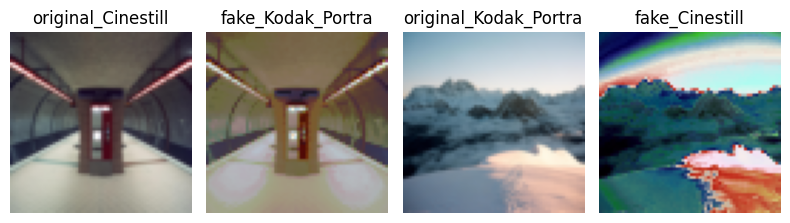

 60%|██████████████████████████████████████████████▊                               | 3000/5000 [13:17<09:03,  3.68it/s]

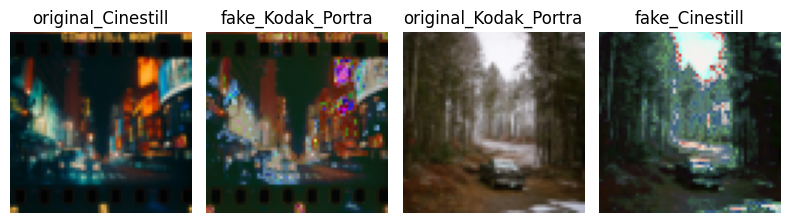

 61%|███████████████████████████████████████████████▌                              | 3050/5000 [13:31<08:11,  3.96it/s]

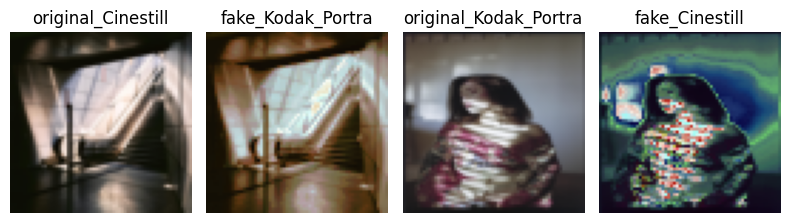

 62%|████████████████████████████████████████████████▎                             | 3100/5000 [13:44<08:10,  3.88it/s]

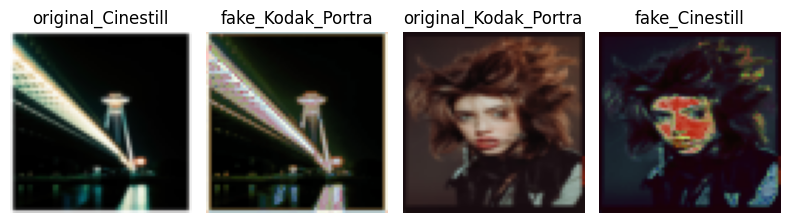

 63%|█████████████████████████████████████████████████▏                            | 3150/5000 [13:56<07:35,  4.06it/s]

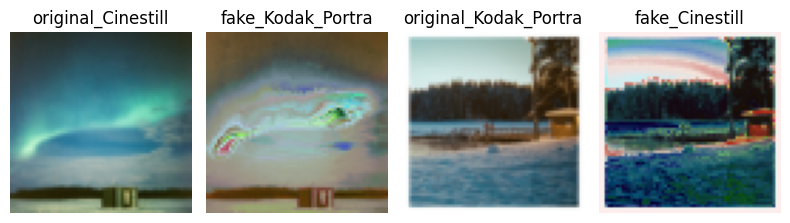

 64%|█████████████████████████████████████████████████▉                            | 3200/5000 [14:09<07:22,  4.07it/s]

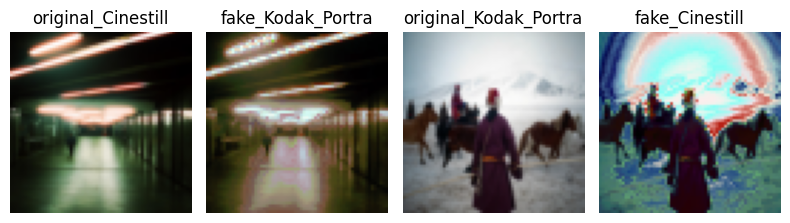

 65%|██████████████████████████████████████████████████▋                           | 3250/5000 [14:22<07:06,  4.10it/s]

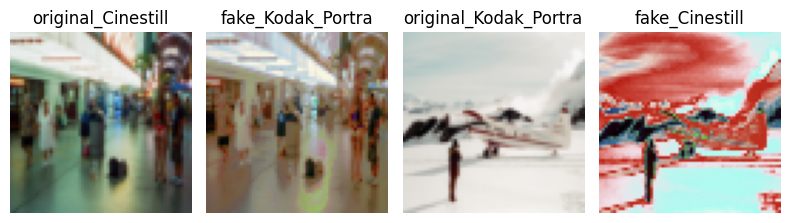

 66%|███████████████████████████████████████████████████▍                          | 3300/5000 [14:34<06:54,  4.10it/s]

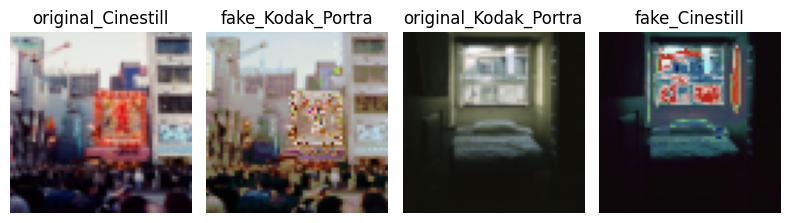

 67%|████████████████████████████████████████████████████▎                         | 3350/5000 [14:47<06:37,  4.15it/s]

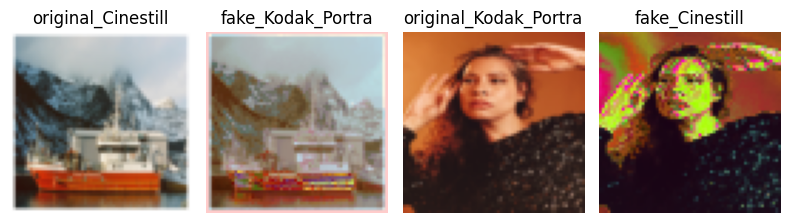

 68%|█████████████████████████████████████████████████████                         | 3400/5000 [15:00<06:26,  4.14it/s]

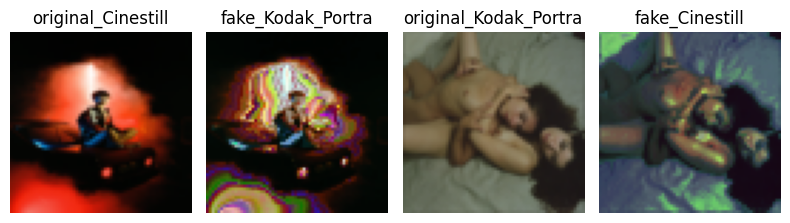

 69%|█████████████████████████████████████████████████████▊                        | 3450/5000 [15:12<06:15,  4.13it/s]

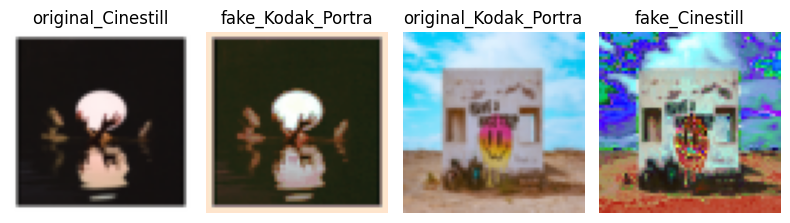

 70%|██████████████████████████████████████████████████████▌                       | 3500/5000 [15:25<06:12,  4.02it/s]

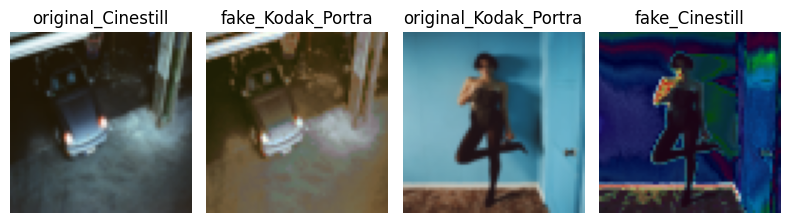

 71%|███████████████████████████████████████████████████████▍                      | 3550/5000 [15:37<05:52,  4.11it/s]

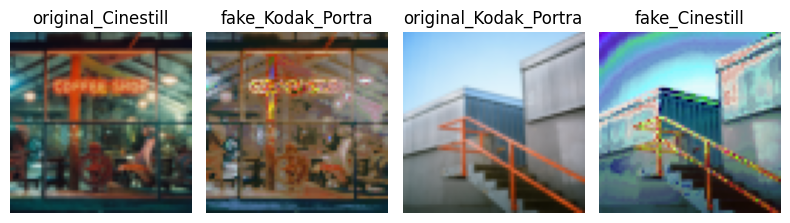

 72%|████████████████████████████████████████████████████████▏                     | 3600/5000 [15:49<05:36,  4.16it/s]

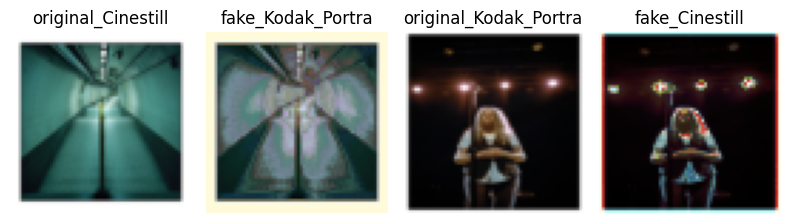

 73%|████████████████████████████████████████████████████████▉                     | 3650/5000 [16:02<05:25,  4.15it/s]

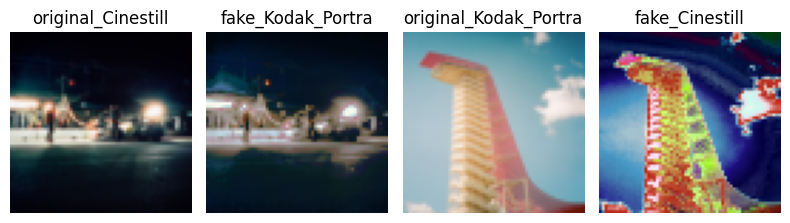

 74%|█████████████████████████████████████████████████████████▋                    | 3700/5000 [16:15<05:20,  4.06it/s]

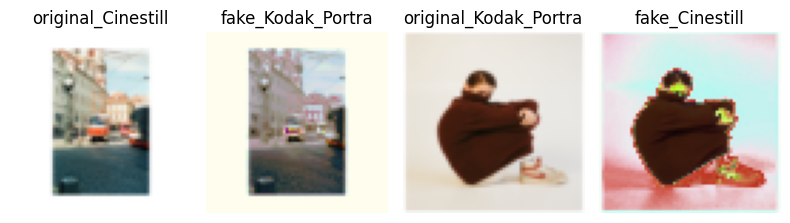

 75%|██████████████████████████████████████████████████████████▌                   | 3750/5000 [16:28<05:07,  4.07it/s]

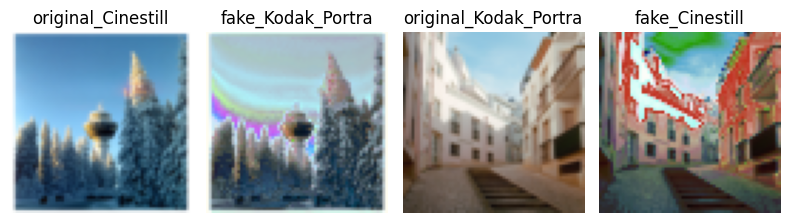

 76%|███████████████████████████████████████████████████████████▎                  | 3800/5000 [16:40<04:56,  4.05it/s]

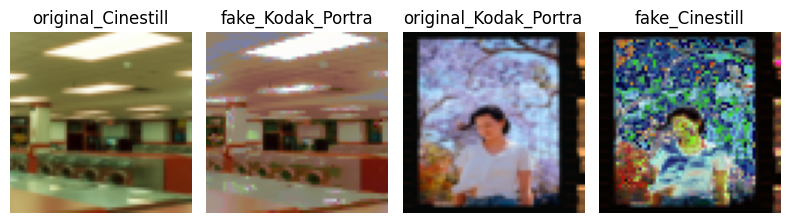

 77%|████████████████████████████████████████████████████████████                  | 3850/5000 [16:53<04:39,  4.11it/s]

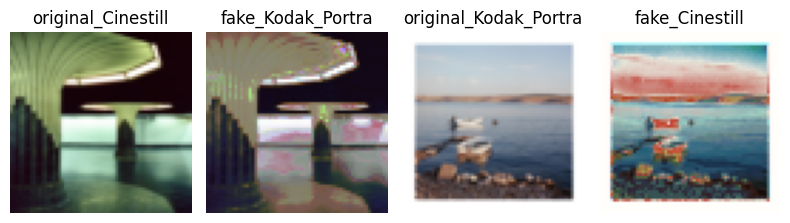

 78%|████████████████████████████████████████████████████████████▊                 | 3900/5000 [17:05<04:27,  4.11it/s]

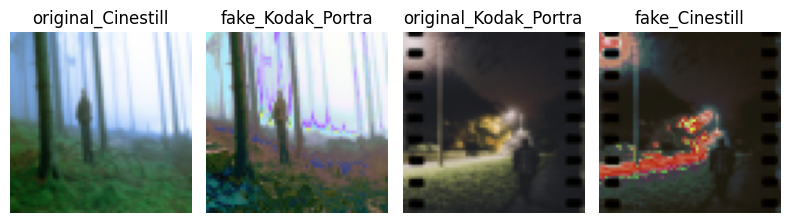

 79%|█████████████████████████████████████████████████████████████▌                | 3950/5000 [17:18<04:19,  4.05it/s]

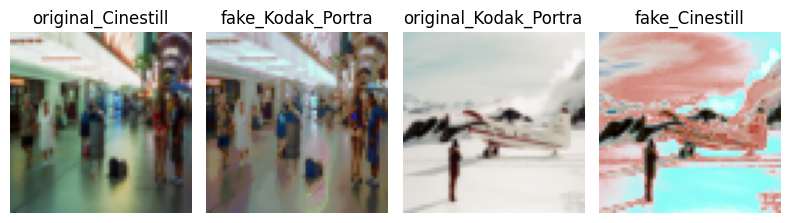

 80%|██████████████████████████████████████████████████████████████▍               | 4000/5000 [17:31<04:06,  4.06it/s]

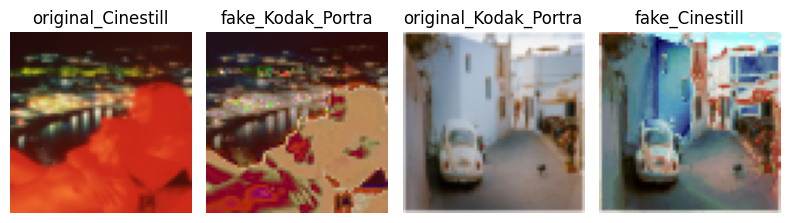

 81%|███████████████████████████████████████████████████████████████▏              | 4050/5000 [17:44<04:09,  3.80it/s]

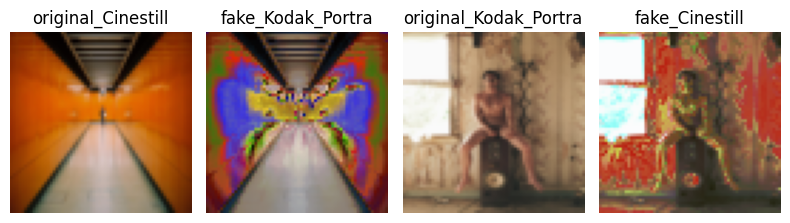

 82%|███████████████████████████████████████████████████████████████▉              | 4100/5000 [17:57<03:53,  3.85it/s]

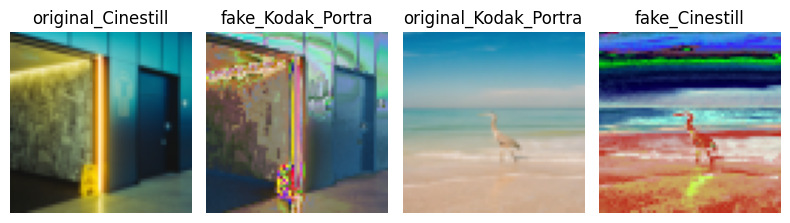

 83%|████████████████████████████████████████████████████████████████▋             | 4150/5000 [18:10<03:25,  4.13it/s]

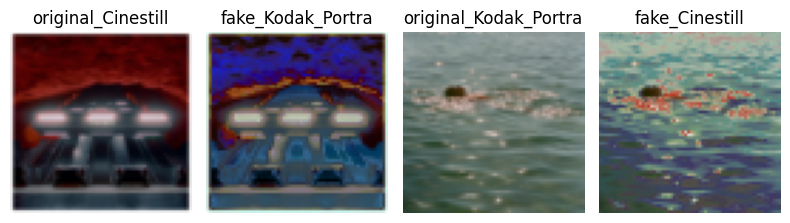

 84%|█████████████████████████████████████████████████████████████████▌            | 4200/5000 [18:23<03:50,  3.47it/s]

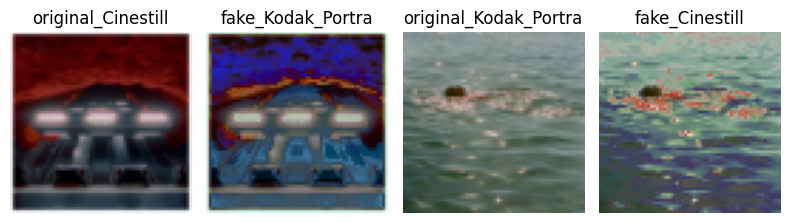

 85%|██████████████████████████████████████████████████████████████████▎           | 4250/5000 [18:37<03:12,  3.90it/s]

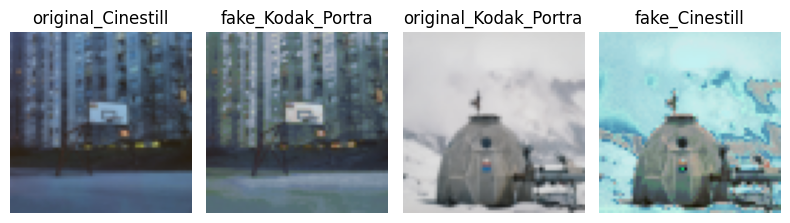

 86%|███████████████████████████████████████████████████████████████████           | 4300/5000 [18:50<03:00,  3.88it/s]

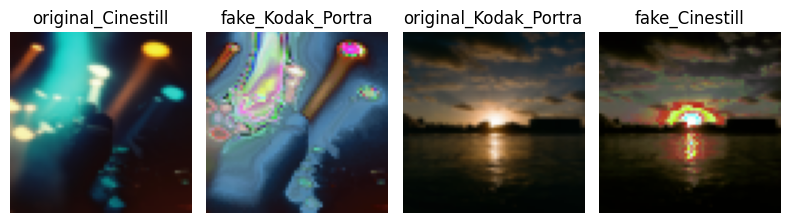

 87%|███████████████████████████████████████████████████████████████████▊          | 4350/5000 [19:04<02:50,  3.81it/s]

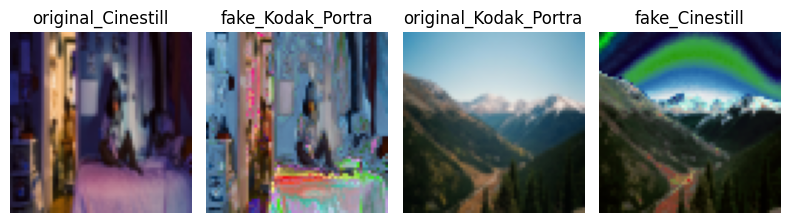

 88%|████████████████████████████████████████████████████████████████████▋         | 4400/5000 [19:17<02:39,  3.75it/s]

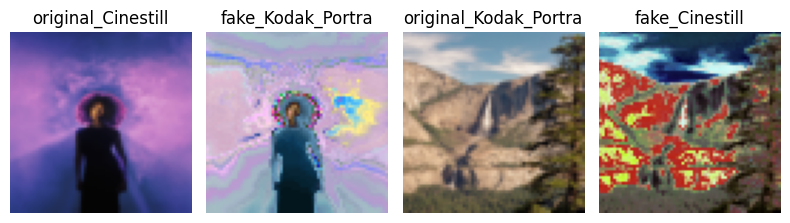

 89%|█████████████████████████████████████████████████████████████████████▍        | 4450/5000 [19:33<02:42,  3.38it/s]

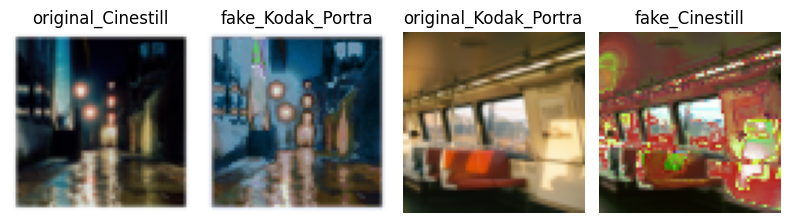

 90%|██████████████████████████████████████████████████████████████████████▏       | 4500/5000 [19:48<02:15,  3.69it/s]

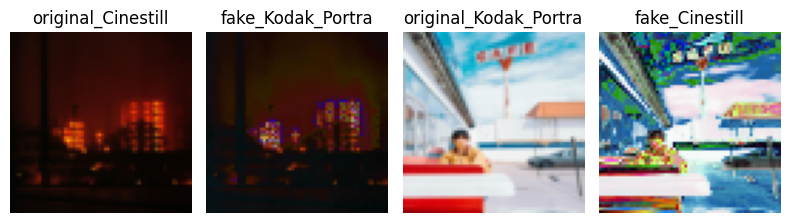

 91%|██████████████████████████████████████████████████████████████████████▉       | 4550/5000 [20:03<02:15,  3.32it/s]

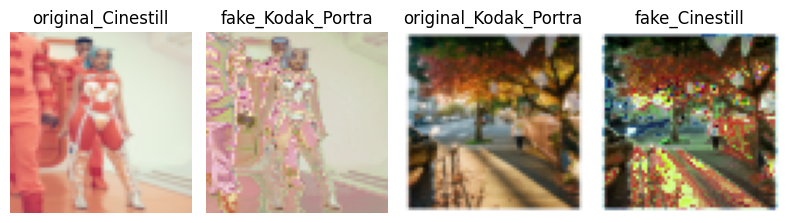

 92%|███████████████████████████████████████████████████████████████████████▊      | 4600/5000 [20:19<01:59,  3.34it/s]

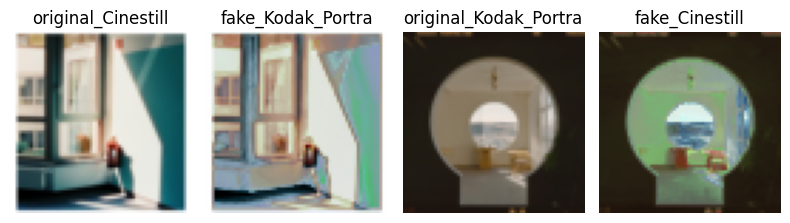

 93%|████████████████████████████████████████████████████████████████████████▌     | 4650/5000 [20:34<01:46,  3.28it/s]

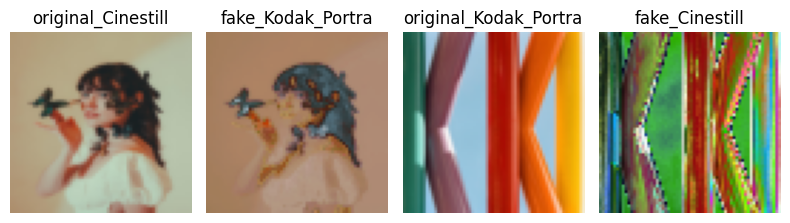

 94%|█████████████████████████████████████████████████████████████████████████▎    | 4700/5000 [20:48<01:32,  3.26it/s]

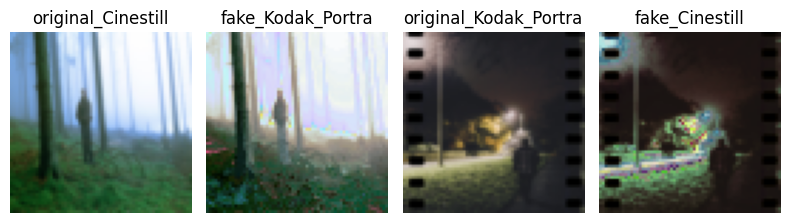

 95%|██████████████████████████████████████████████████████████████████████████    | 4750/5000 [21:04<01:16,  3.26it/s]

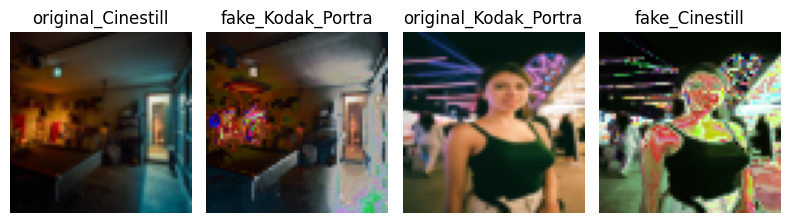

 96%|██████████████████████████████████████████████████████████████████████████▉   | 4800/5000 [21:20<00:58,  3.40it/s]

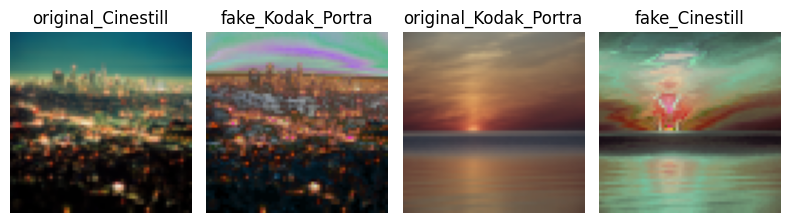

 97%|███████████████████████████████████████████████████████████████████████████▋  | 4850/5000 [21:34<00:42,  3.56it/s]

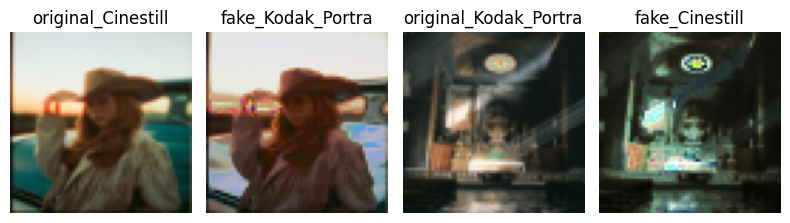

 98%|████████████████████████████████████████████████████████████████████████████▍ | 4900/5000 [21:51<00:35,  2.83it/s]

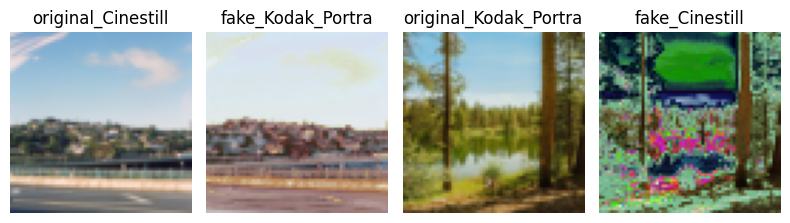

 99%|█████████████████████████████████████████████████████████████████████████████▏| 4950/5000 [22:08<00:13,  3.78it/s]

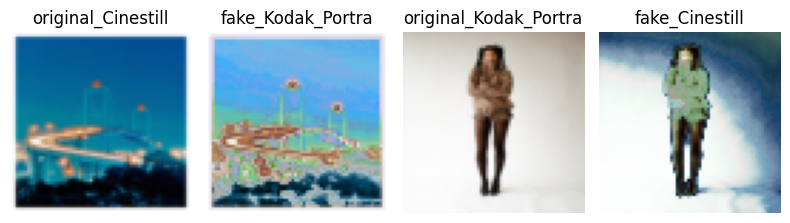

100%|██████████████████████████████████████████████████████████████████████████████| 5000/5000 [22:22<00:00,  3.73it/s]


In [24]:
G_Losses, D_Losses = train_cycle_gan(netD_A, netD_B, netG_A2B, netG_B2A, dataloader, opt_disc, opt_gen, L1, mse, d_scaler, g_scaler, num_epochs)

In [25]:
G_Losses_cpu = [float(loss.detach().cpu().numpy()) for loss in G_Losses]
D_Losses_cpu = [float(loss.detach().cpu().numpy()) for loss in D_Losses]

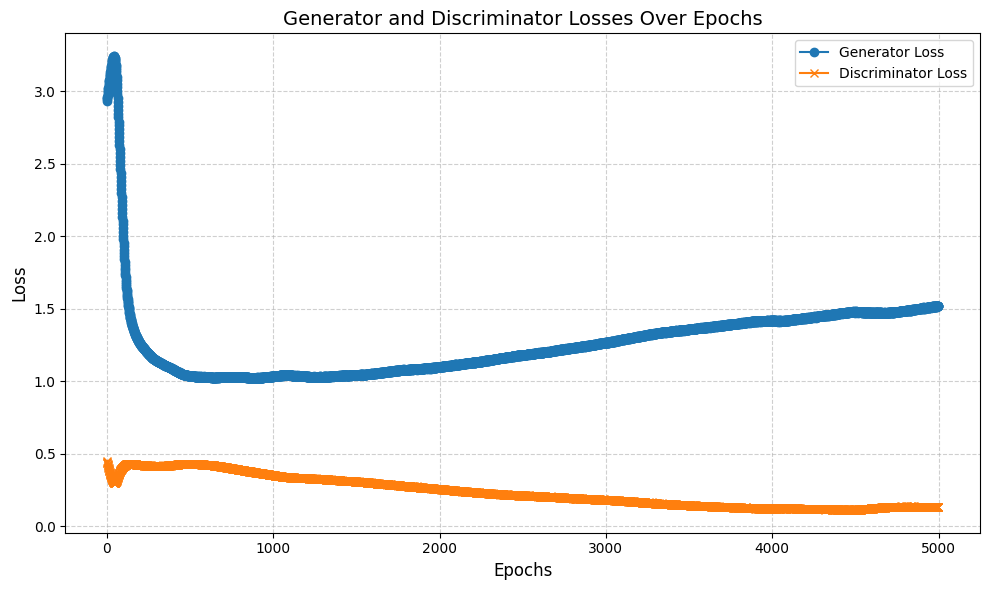

In [26]:
plt.figure(figsize=(10, 6))

plt.plot(G_Losses_cpu, label="Generator Loss", marker='o')

plt.plot(D_Losses_cpu, label="Discriminator Loss", marker='x')

plt.title("Generator and Discriminator Losses Over Epochs", fontsize=14)

plt.xlabel("Epochs", fontsize=12)

plt.ylabel("Loss", fontsize=12)

plt.legend(fontsize=10)

plt.grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()

plt.show()

As we can see above the loss deceases rapidly for our generators in the first 200 episodes. The discriminitor loss decreases consistently throughout the 5000 episodes. \
For some reason our generators do not improve from episode 1000 onwards. Instead, their loss is increasing, which could indicate instability in training. 

## Save model for evaluation
We will evaluate our models in the notebook `VAL_Models`.

In [27]:
def save_checkpoint(model, optimizer, directory, filename="models/checkpoint.pth.tar"):
    print("=> Saving checkpoint")
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),
    }
    directory = f"models/{directory}"
    # Create the directory if it doesn't exist
    if not os.path.exists(directory):
        os.makedirs(directory)
        
    torch.save(checkpoint, os.path.join(directory, filename))

In [28]:
save_checkpoint(netG_A2B, opt_gen, directory=experiment, filename=check_G_A2B)
save_checkpoint(netG_B2A, opt_gen, directory=experiment, filename=check_G_B2A)
save_checkpoint(netD_A, opt_disc, directory=experiment, filename=check_D_A)
save_checkpoint(netD_B, opt_disc, directory=experiment, filename=check_D_B)

=> Saving checkpoint
=> Saving checkpoint
=> Saving checkpoint
=> Saving checkpoint
